## Project - Bank Term Deposit Sale

### Problem statement

##### Goal
Using the data collected from existing customers, build a model that will help the marketing
team identify potential customers who are relatively more likely to subscribe term deposit
and thus increase their hit ratio.

##### Resources Available
The historical data for this project is available in file
https://archive.ics.uci.edu/ml/datasets/Bank+Marketing
    
#### Attribute information

##### Input variables:

###### Bank client data:
1. age: Continuous feature
2. job: Type of job (management, technician, entrepreneur, blue-collar, etc.)
3. marital: marital status (married, single, divorced)
4. education: education level (primary, secondary, tertiary)
5. default: has credit in default?
6. housing: has housing loan?
7. loan: has personal loan?
8. balance in account

##### Related to previous contact:
9. contact: contact communication type
10. month: last contact month of year
11. day: last contact day of the month
12. duration: last contact duration, in seconds*

##### Other attributes:
13. campaign: number of contacts performed during this campaign and for this
client
14. pdays: number of days that passed by after the client was last contacted from a
previous campaign (-1 tells us the person has not been contacted or contact
period is beyond 900 days)
15. previous: number of times the client has been contacted before for the last
campaign to subscribe term deposit
16. poutcome: outcome of the previous marketing campaign
Output variable (desired target):
17. Target: Tell us has the client subscribed a term deposit. (Yes, No)

#### 1. Import the necessary packages

In [1]:
#Load Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import datetime
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings('ignore')

#### Read the dataset into dataframes

In [3]:
bank_deposit_df = pd.read_csv("bank-full.csv")
bank_deposit_df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,Target
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no


In [4]:
bank_deposit_df.tail()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,Target
45206,51,technician,married,tertiary,no,825,no,no,cellular,17,nov,977,3,-1,0,unknown,yes
45207,71,retired,divorced,primary,no,1729,no,no,cellular,17,nov,456,2,-1,0,unknown,yes
45208,72,retired,married,secondary,no,5715,no,no,cellular,17,nov,1127,5,184,3,success,yes
45209,57,blue-collar,married,secondary,no,668,no,no,telephone,17,nov,508,4,-1,0,unknown,no
45210,37,entrepreneur,married,secondary,no,2971,no,no,cellular,17,nov,361,2,188,11,other,no


#### Apply info, shape, describe, and find the number of missing values in the data 

In [5]:
# Check to see the number of records in the dataset
bank_deposit_df.shape

(45211, 17)

#### Observation: The dataset comprises of 45211 rows and 17 columns

In [6]:
print(bank_deposit_df.columns)

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'Target'],
      dtype='object')


In [7]:
bank_deposit_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  Target     45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


#### Observations: 
<ul>
    <li>All the columns of the dataset have the same number of non-null values</li>
    <li>Some columns are of data type integer and some (categorical features) are of the data type object</li>
    <li>Numerical attributes - age, balance, day, duration, campaign, pdays, previous</li>
    <li>Categorical attributes - job, marital, education, default, housing, loan, contact, month, poutcome, Target</li>
</ul>

In [8]:
# Converting the data type of the categorical columns
cat_cols = ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'month', 'poutcome', 'Target']
for col in cat_cols:
    bank_deposit_df[col] = bank_deposit_df[col].astype('category')

In [9]:
bank_deposit_df.dtypes

age             int64
job          category
marital      category
education    category
default      category
balance         int64
housing      category
loan         category
contact      category
day             int64
month        category
duration        int64
campaign        int64
pdays           int64
previous        int64
poutcome     category
Target       category
dtype: object

In [10]:
# Check to see if data has any missing values
bank_deposit_df.isnull().any()

age          False
job          False
marital      False
education    False
default      False
balance      False
housing      False
loan         False
contact      False
day          False
month        False
duration     False
campaign     False
pdays        False
previous     False
poutcome     False
Target       False
dtype: bool

#### Observation: No Null Values are present 

In [11]:
#Analyze the distribution of the dataset
bank_deposit_df.describe(include = 'all')

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,Target
count,45211.000000,45211,45211,45211,45211,45211.000000,45211,45211,45211,45211.000000,45211,45211.000000,45211.000000,45211.000000,45211.000000,45211,45211
unique,NaN,12,3,4,2,NaN,2,2,3,NaN,12,NaN,NaN,NaN,NaN,4,2
top,NaN,blue-collar,married,secondary,no,NaN,yes,no,cellular,NaN,may,NaN,NaN,NaN,NaN,unknown,no
freq,NaN,9732,27214,23202,44396,NaN,25130,37967,29285,NaN,13766,NaN,NaN,NaN,NaN,36959,39922
mean,40.936210,NaN,NaN,NaN,NaN,1362.272058,NaN,NaN,NaN,15.806419,NaN,258.163080,2.763841,40.197828,0.580323,NaN,NaN
std,10.618762,NaN,NaN,NaN,NaN,3044.765829,NaN,NaN,NaN,8.322476,NaN,257.527812,3.098021,100.128746,2.303441,NaN,NaN
min,18.000000,NaN,NaN,NaN,NaN,-8019.000000,NaN,NaN,NaN,1.000000,NaN,0.000000,1.000000,-1.000000,0.000000,NaN,NaN
25%,33.000000,NaN,NaN,NaN,NaN,72.000000,NaN,NaN,NaN,8.000000,NaN,103.000000,1.000000,-1.000000,0.000000,NaN,NaN
50%,39.000000,NaN,NaN,NaN,NaN,448.000000,NaN,NaN,NaN,16.000000,NaN,180.000000,2.000000,-1.000000,0.000000,NaN,NaN
75%,48.000000,NaN,NaN,NaN,NaN,1428.000000,NaN,NaN,NaN,21.000000,NaN,319.000000,3.000000,-1.000000,0.000000,NaN,NaN


In [12]:
bank_deposit_df.describe(include = 'all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
age,45211,NaN,NaN,NaN,40.9362,10.6188,18,33,39,48,95
job,45211,12,blue-collar,9732,NaN,NaN,NaN,NaN,NaN,NaN,NaN
marital,45211,3,married,27214,NaN,NaN,NaN,NaN,NaN,NaN,NaN
education,45211,4,secondary,23202,NaN,NaN,NaN,NaN,NaN,NaN,NaN
default,45211,2,no,44396,NaN,NaN,NaN,NaN,NaN,NaN,NaN
balance,45211,NaN,NaN,NaN,1362.27,3044.77,-8019,72,448,1428,102127
housing,45211,2,yes,25130,NaN,NaN,NaN,NaN,NaN,NaN,NaN
loan,45211,2,no,37967,NaN,NaN,NaN,NaN,NaN,NaN,NaN
contact,45211,3,cellular,29285,NaN,NaN,NaN,NaN,NaN,NaN,NaN
day,45211,NaN,NaN,NaN,15.8064,8.32248,1,8,16,21,31


#### Observations from Descriptive Statistics of Numerical Attributes
<ul>
    <li> For attributes 'age', 'duration and 'campaign', mean seems to be slightly greater than median and so we can say that they are right (positively) skewed</li>
<li> For attributes 'pdays' and 'previous', 75% of data values are around -1 and 0 which are dummy values and need further exploration</li>
</ul>

In [13]:
num_cols = ['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous']

Attribute:  age
Minimum:  18
Maximum:  95
Mean:  40.93621021432837
Median:  39.0
Standard deviation:  10.618762040975431
1st Quartile (Q1) is:  33.0
3st Quartile (Q3) is:  48.0
Lower outliers:  10.5
Upper outliers:  70.5


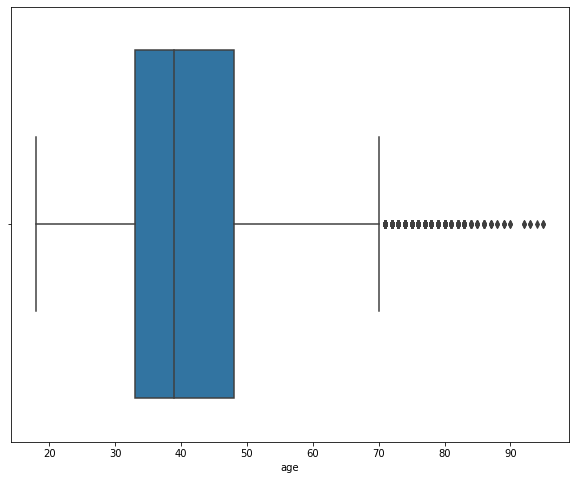

-------------------------------------------------------------------------
Attribute:  balance
Minimum:  -8019
Maximum:  102127
Mean:  1362.2720576850766
Median:  448.0
Standard deviation:  3044.7658291686002
1st Quartile (Q1) is:  72.0
3st Quartile (Q3) is:  1428.0
Lower outliers:  -1962.0
Upper outliers:  3462.0


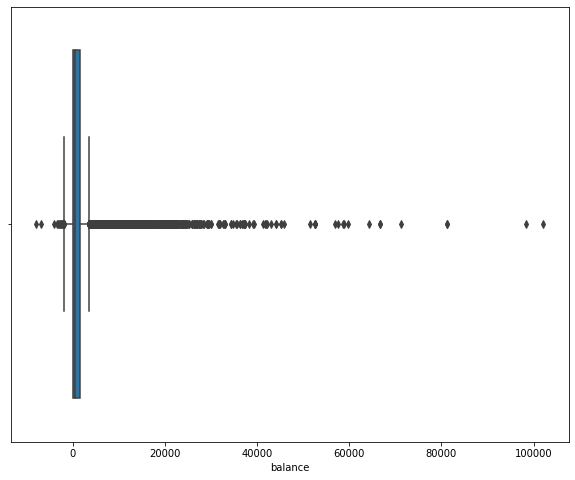

-------------------------------------------------------------------------
Attribute:  day
Minimum:  1
Maximum:  31
Mean:  15.80641879188693
Median:  16.0
Standard deviation:  8.322476153044185
1st Quartile (Q1) is:  8.0
3st Quartile (Q3) is:  21.0
Lower outliers:  -11.5
Upper outliers:  40.5


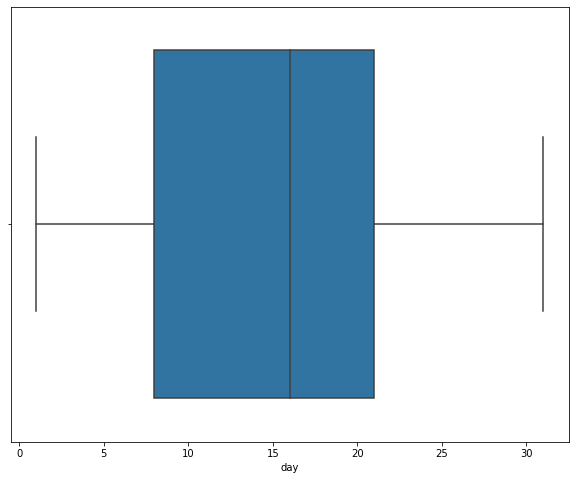

-------------------------------------------------------------------------
Attribute:  duration
Minimum:  0
Maximum:  4918
Mean:  258.1630797814691
Median:  180.0
Standard deviation:  257.52781226517095
1st Quartile (Q1) is:  103.0
3st Quartile (Q3) is:  319.0
Lower outliers:  -221.0
Upper outliers:  643.0


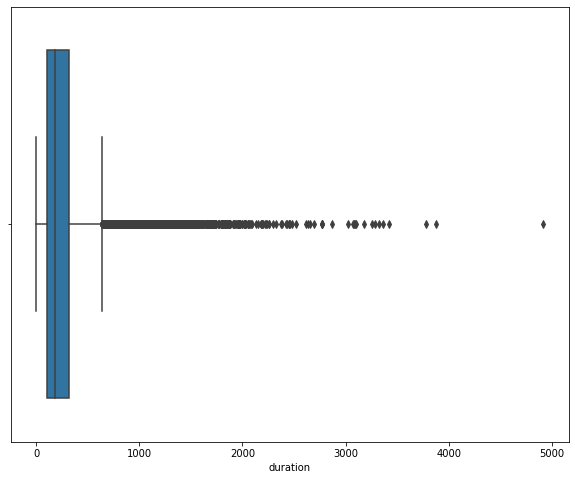

-------------------------------------------------------------------------
Attribute:  campaign
Minimum:  1
Maximum:  63
Mean:  2.763840658246887
Median:  2.0
Standard deviation:  3.0980208832802205
1st Quartile (Q1) is:  1.0
3st Quartile (Q3) is:  3.0
Lower outliers:  -2.0
Upper outliers:  6.0


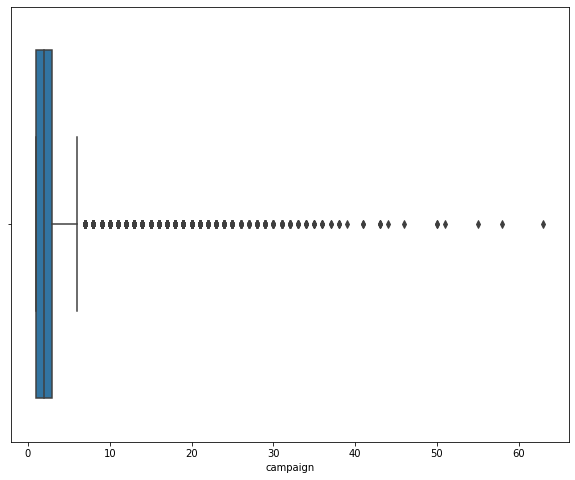

-------------------------------------------------------------------------
Attribute:  pdays
Minimum:  -1
Maximum:  871
Mean:  40.19782796222158
Median:  -1.0
Standard deviation:  100.1287459906047
1st Quartile (Q1) is:  -1.0
3st Quartile (Q3) is:  -1.0
Lower outliers:  -1.0
Upper outliers:  -1.0


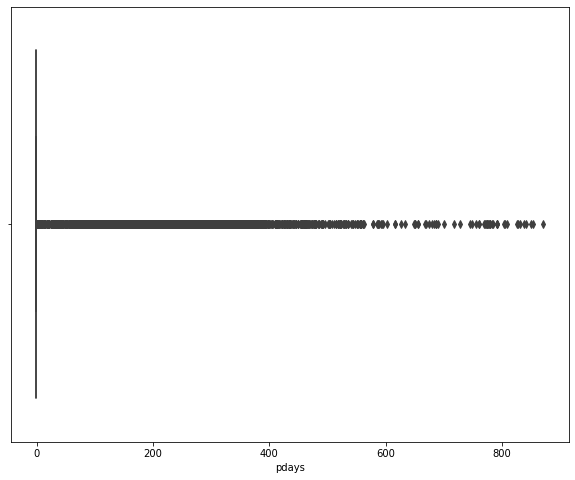

-------------------------------------------------------------------------
Attribute:  previous
Minimum:  0
Maximum:  275
Mean:  0.5803233726305546
Median:  0.0
Standard deviation:  2.3034410449314233
1st Quartile (Q1) is:  0.0
3st Quartile (Q3) is:  0.0
Lower outliers:  0.0
Upper outliers:  0.0


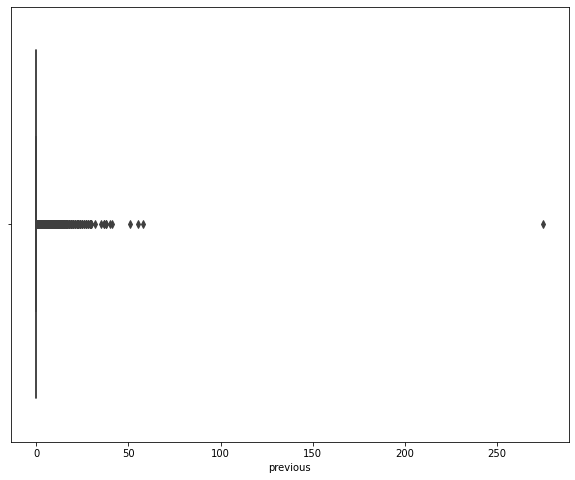

-------------------------------------------------------------------------


In [14]:
# Central tendency distribution 
i = 1
for col in num_cols:
    print('Attribute: ',col)
    print('Minimum: ',bank_deposit_df[col].min())
    print('Maximum: ',bank_deposit_df[col].max())
    print('Mean: ', bank_deposit_df[col].mean())
    print('Median: ',bank_deposit_df[col].median())
    print('Standard deviation: ', bank_deposit_df[col].std())
    Q1 = bank_deposit_df[col].quantile(q=0.25)
    Q3 = bank_deposit_df[col].quantile(q=0.75)
    print('1st Quartile (Q1) is: ', Q1)
    print('3st Quartile (Q3) is: ', Q3)
    L_outliers=Q1-1.5*(Q3-Q1)
    U_outliers=Q3+1.5*(Q3-Q1)
    print('Lower outliers: ', L_outliers)
    print('Upper outliers: ', U_outliers)
    plt.figure(figsize=(10,8))
    sns.boxplot(bank_deposit_df[col])
    plt.show();
    i = i+1
    print('-------------------------------------------------------------------------')

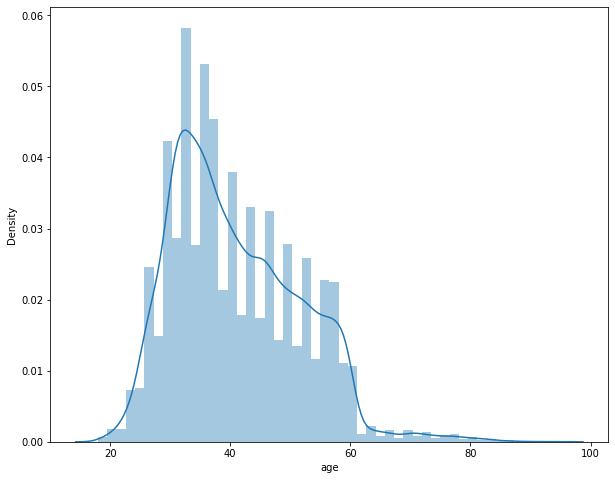

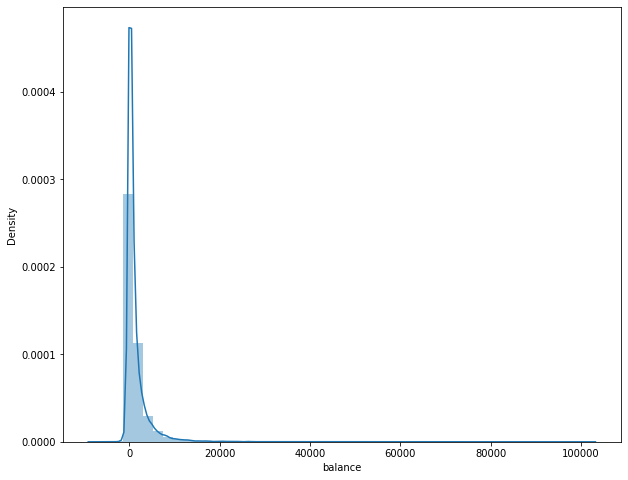

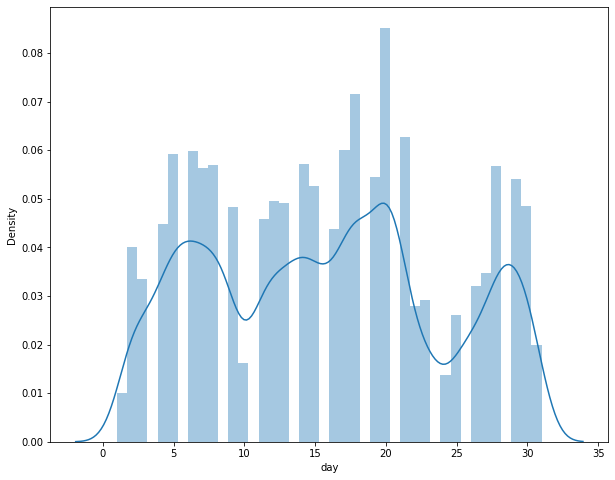

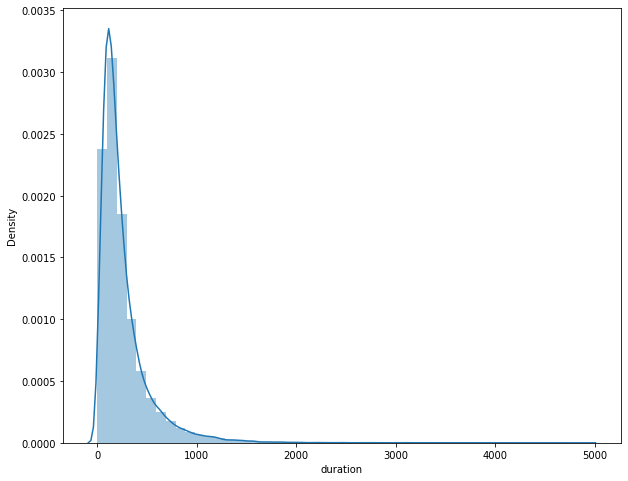

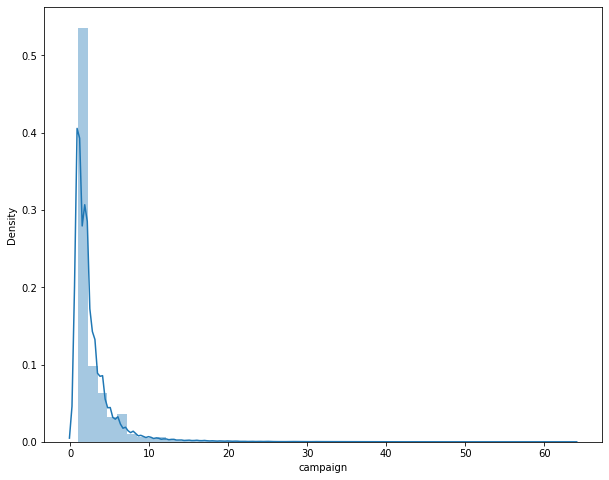

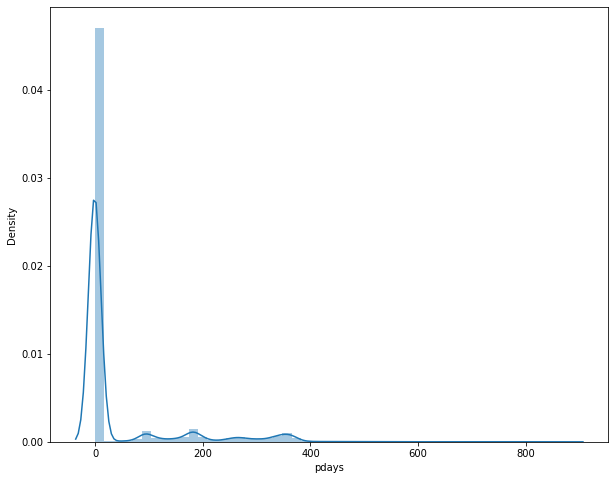

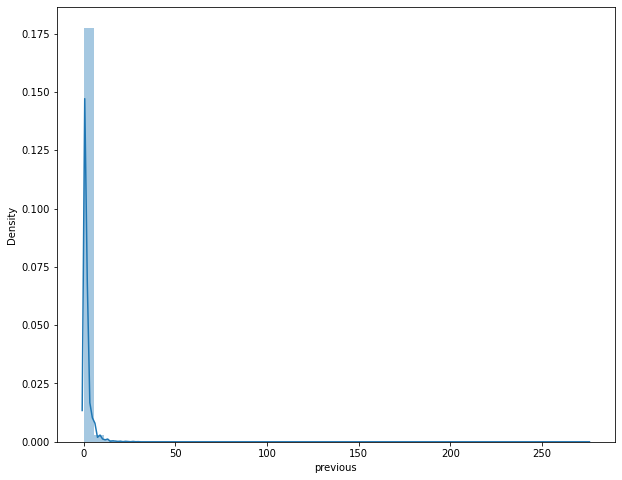

In [15]:
# Skewness distribution
i = 1
for col in num_cols:
    plt.figure(figsize=(10,8))
    sns.distplot(bank_deposit_df[col])
    i = i+1

In [16]:
# Check the unique values in each column of the dataframe
bank_deposit_df.nunique()

age            77
job            12
marital         3
education       4
default         2
balance      7168
housing         2
loan            2
contact         3
day            31
month          12
duration     1573
campaign       48
pdays         559
previous       41
poutcome        4
Target          2
dtype: int64

In [17]:
import pandas_profiling
bank_deposit_df.profile_report()

In [18]:
from pandas_profiling import ProfileReport

profile = ProfileReport(bank_deposit_df, title="Pandas Profiling Report")
profile.to_widgets()

### Distribution of Target variable

In [19]:
bank_deposit_df.Target.nunique()

2

In [20]:
bank_deposit_df.Target.unique()

['no', 'yes']
Categories (2, object): ['no', 'yes']

In [21]:
bank_deposit_df["Target"].value_counts()

no     39922
yes     5289
Name: Target, dtype: int64

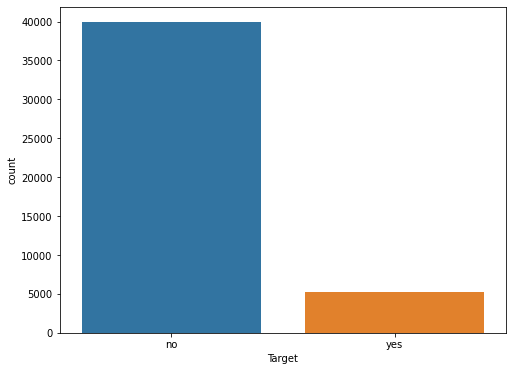

In [22]:
# Plot the distribution of the target attribute
plt.figure(figsize=(8,6))
sns.countplot(bank_deposit_df['Target'],data=bank_deposit_df);
plt.show()

### Encoding categorical variables

In [23]:
#importing the Encoding library
from sklearn.preprocessing import LabelEncoder

labelencoder_X = LabelEncoder()
bank_deposit_df['job']=labelencoder_X.fit_transform(bank_deposit_df['job'])
bank_deposit_df['marital']=labelencoder_X.fit_transform(bank_deposit_df['marital'])
bank_deposit_df['education']=labelencoder_X.fit_transform(bank_deposit_df['education'])
bank_deposit_df['default']=labelencoder_X.fit_transform(bank_deposit_df['default'])
bank_deposit_df['housing']=labelencoder_X.fit_transform(bank_deposit_df['housing'])
bank_deposit_df['loan']=labelencoder_X.fit_transform(bank_deposit_df['loan'])
bank_deposit_df['contact']= labelencoder_X.fit_transform(bank_deposit_df['contact']) 
bank_deposit_df['month']= labelencoder_X.fit_transform(bank_deposit_df['month']) 
bank_deposit_df['poutcome'] = labelencoder_X.fit_transform(bank_deposit_df['poutcome'])
bank_deposit_df['Target'] = labelencoder_X.fit_transform(bank_deposit_df['Target'])

In [24]:
bank_deposit_df.head(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,Target
0,58,4,1,2,0,2143,1,0,2,5,8,261,1,-1,0,3,0
1,44,9,2,1,0,29,1,0,2,5,8,151,1,-1,0,3,0
2,33,2,1,1,0,2,1,1,2,5,8,76,1,-1,0,3,0
3,47,1,1,3,0,1506,1,0,2,5,8,92,1,-1,0,3,0
4,33,11,2,3,0,1,0,0,2,5,8,198,1,-1,0,3,0
5,35,4,1,2,0,231,1,0,2,5,8,139,1,-1,0,3,0
6,28,4,2,2,0,447,1,1,2,5,8,217,1,-1,0,3,0
7,42,2,0,2,1,2,1,0,2,5,8,380,1,-1,0,3,0
8,58,5,1,0,0,121,1,0,2,5,8,50,1,-1,0,3,0
9,43,9,2,1,0,593,1,0,2,5,8,55,1,-1,0,3,0


In [25]:
bank_deposit_df.describe().T

,count,mean,std,min,25%,50%,75%,max
age,45211.0,40.936210,10.618762,18.0,33.0,39.0,48.0,95.0
job,45211.0,4.339762,3.272657,0.0,1.0,4.0,7.0,11.0
marital,45211.0,1.167725,0.608230,0.0,1.0,1.0,2.0,2.0
education,45211.0,1.224813,0.747997,0.0,1.0,1.0,2.0,3.0
default,45211.0,0.018027,0.133049,0.0,0.0,0.0,0.0,1.0
balance,45211.0,1362.272058,3044.765829,-8019.0,72.0,448.0,1428.0,102127.0
housing,45211.0,0.555838,0.496878,0.0,0.0,1.0,1.0,1.0
loan,45211.0,0.160226,0.366820,0.0,0.0,0.0,0.0,1.0
contact,45211.0,0.640242,0.897951,0.0,0.0,0.0,2.0,2.0
day,45211.0,15.806419,8.322476,1.0,8.0,16.0,21.0,31.0


### Bivariate Analysis

#### Categorical Independent Variables vs Target Variable

In [26]:
cat_cols.pop()
print(cat_cols)

['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'month', 'poutcome']


Target         0         1
job                       
0       0.877973  0.122027
1       0.927250  0.072750
2       0.917283  0.082717
3       0.912097  0.087903
4       0.862444  0.137556
5       0.772085  0.227915
6       0.881571  0.118429
7       0.911170  0.088830
8       0.713220  0.286780
9       0.889430  0.110570
10      0.844973  0.155027
11      0.881944  0.118056


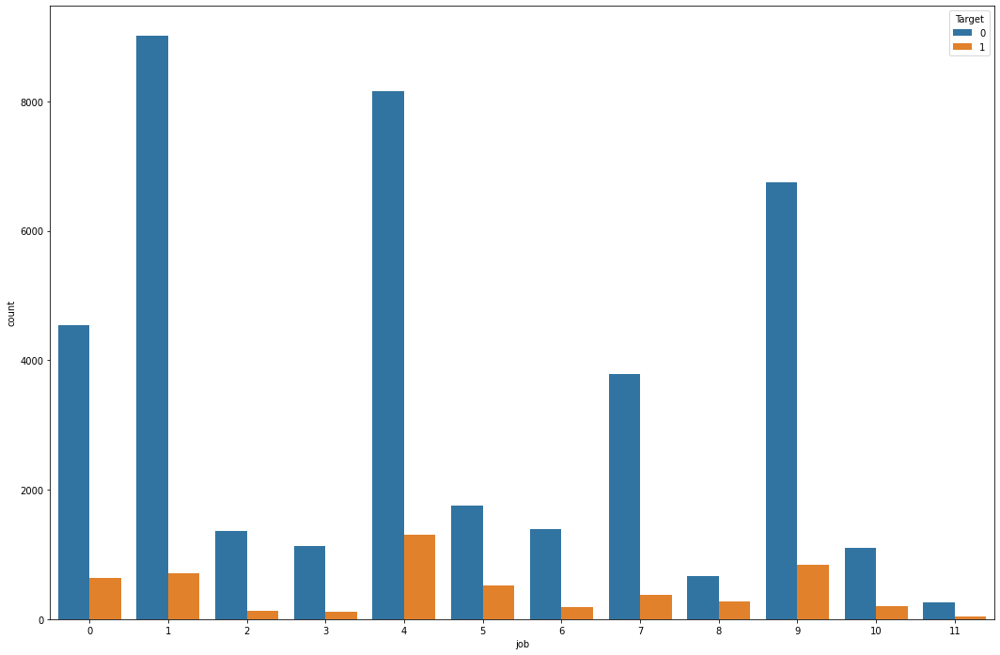

------------------------------------------------------------------------------------------------
Target          0         1
marital                    
0        0.880545  0.119455
1        0.898765  0.101235
2        0.850508  0.149492


<Figure size 432x288 with 0 Axes>

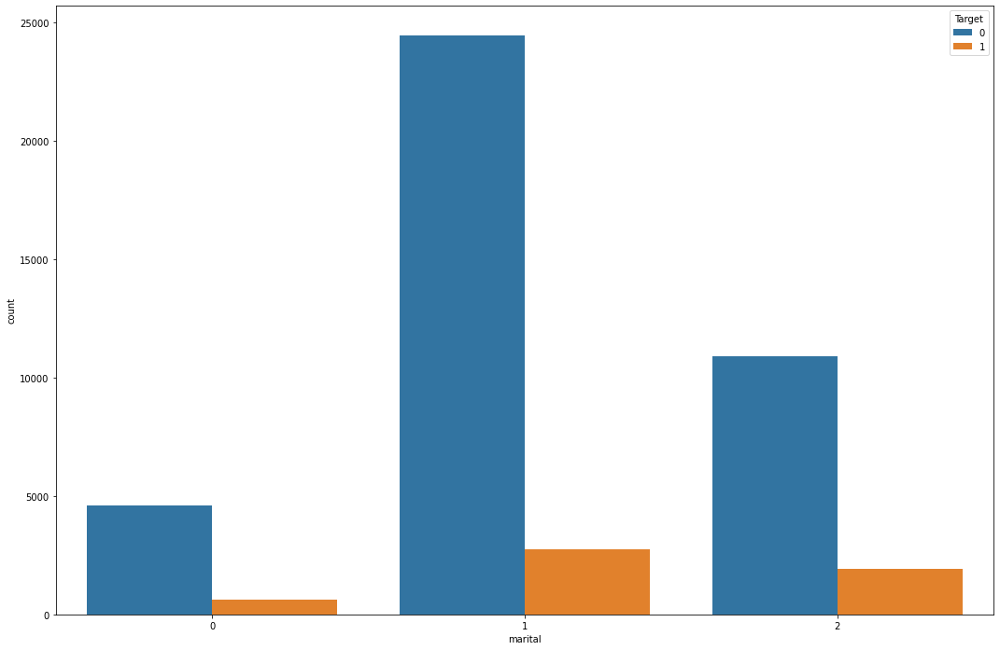

------------------------------------------------------------------------------------------------
Target            0         1
education                    
0          0.913735  0.086265
1          0.894406  0.105594
2          0.849936  0.150064
3          0.864297  0.135703


<Figure size 432x288 with 0 Axes>

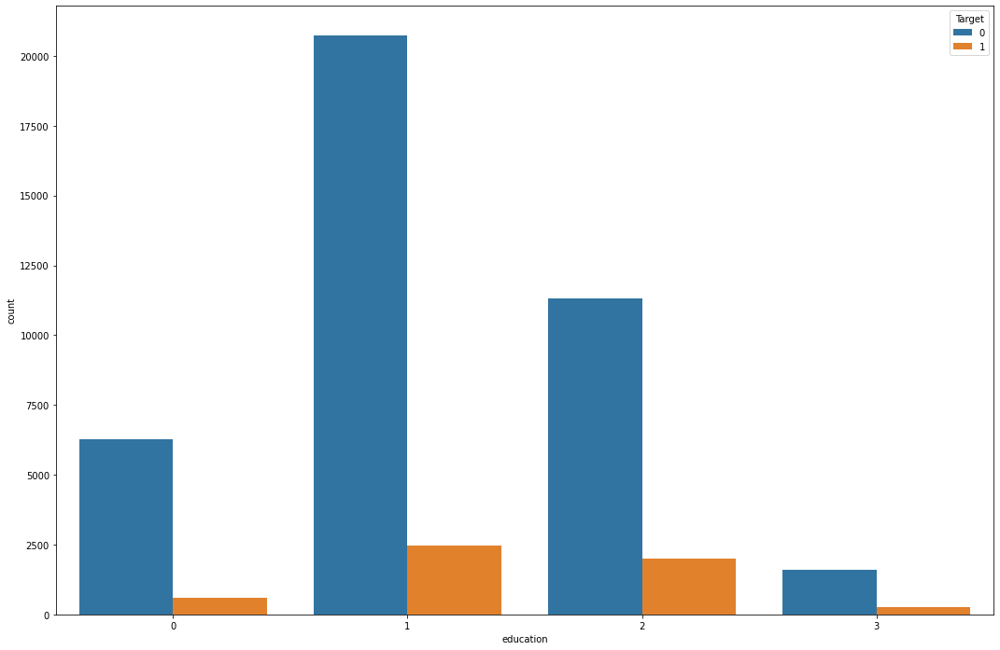

------------------------------------------------------------------------------------------------
Target          0         1
default                    
0        0.882039  0.117961
1        0.936196  0.063804


<Figure size 432x288 with 0 Axes>

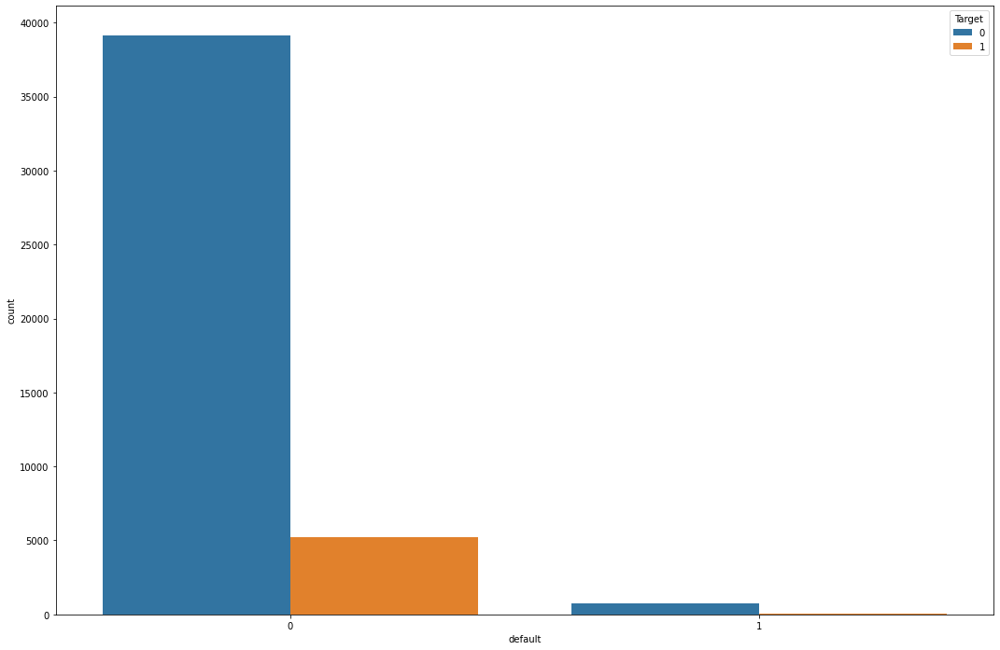

------------------------------------------------------------------------------------------------
Target          0         1
housing                    
0        0.832976  0.167024
1        0.923000  0.077000


<Figure size 432x288 with 0 Axes>

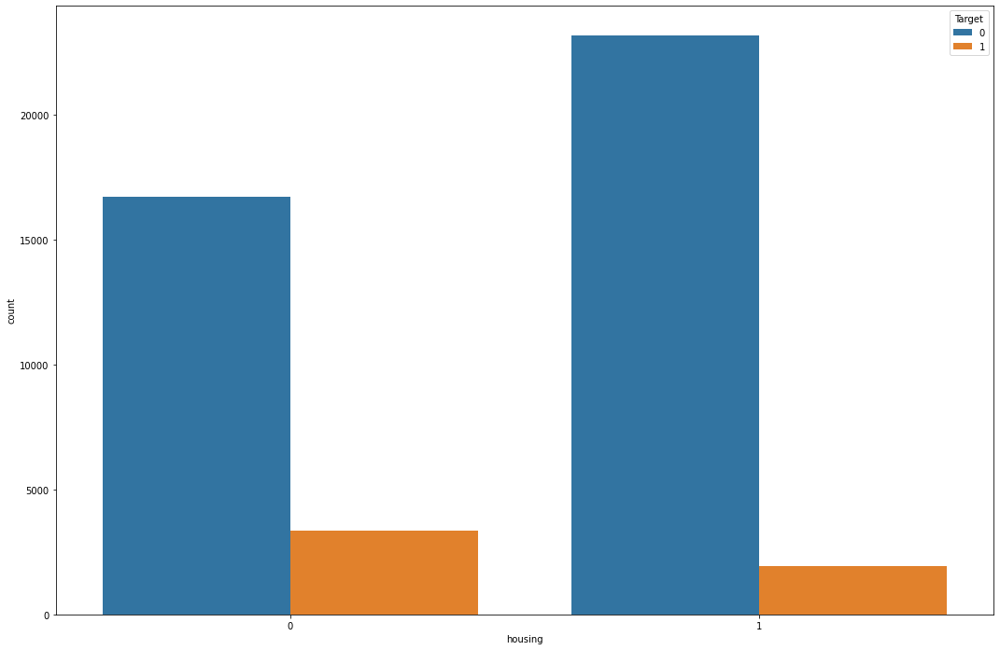

------------------------------------------------------------------------------------------------
Target         0         1
loan                      
0       0.873443  0.126557
1       0.933186  0.066814


<Figure size 432x288 with 0 Axes>

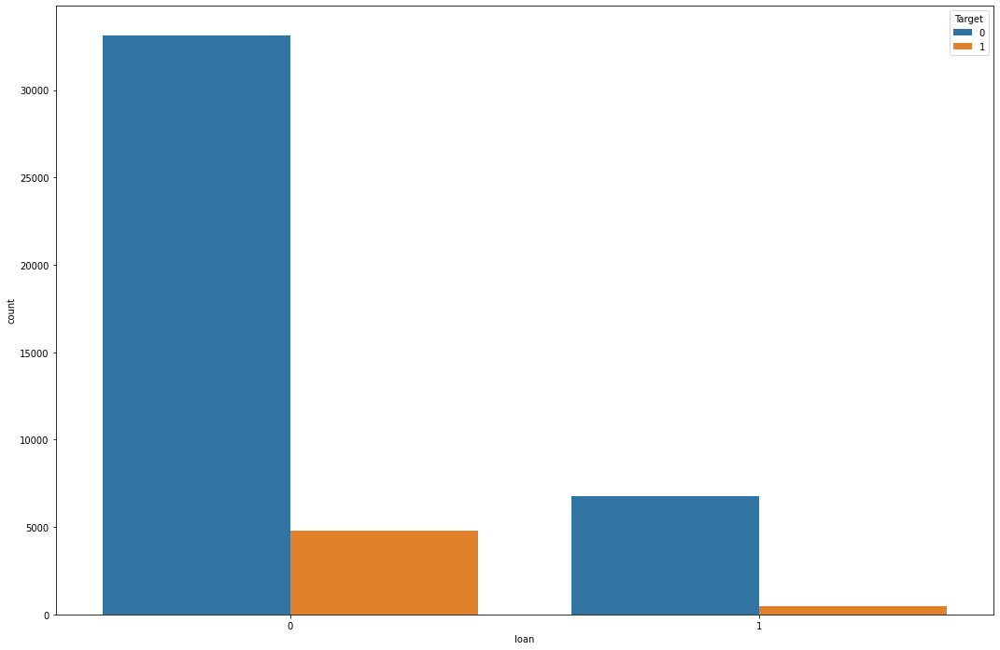

------------------------------------------------------------------------------------------------
Target          0         1
contact                    
0        0.850811  0.149189
1        0.865795  0.134205
2        0.959293  0.040707


<Figure size 432x288 with 0 Axes>

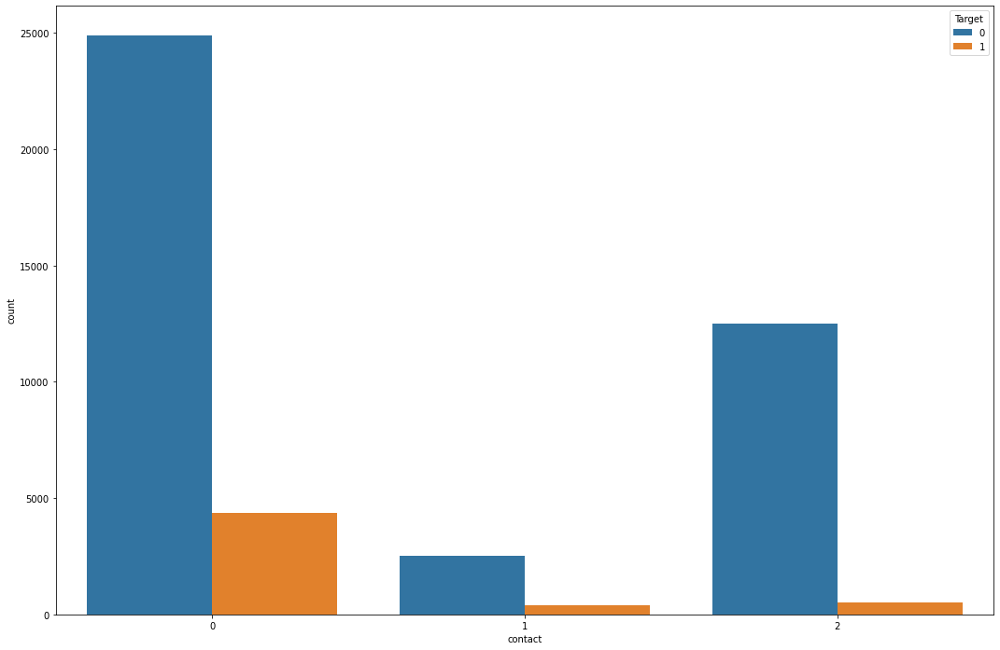

------------------------------------------------------------------------------------------------
Target         0         1
month                     
0       0.803206  0.196794
1       0.889867  0.110133
2       0.532710  0.467290
3       0.833522  0.166478
4       0.898788  0.101212
5       0.909065  0.090935
6       0.897772  0.102228
7       0.480084  0.519916
8       0.932805  0.067195
9       0.898489  0.101511
10      0.562331  0.437669
11      0.535406  0.464594


<Figure size 432x288 with 0 Axes>

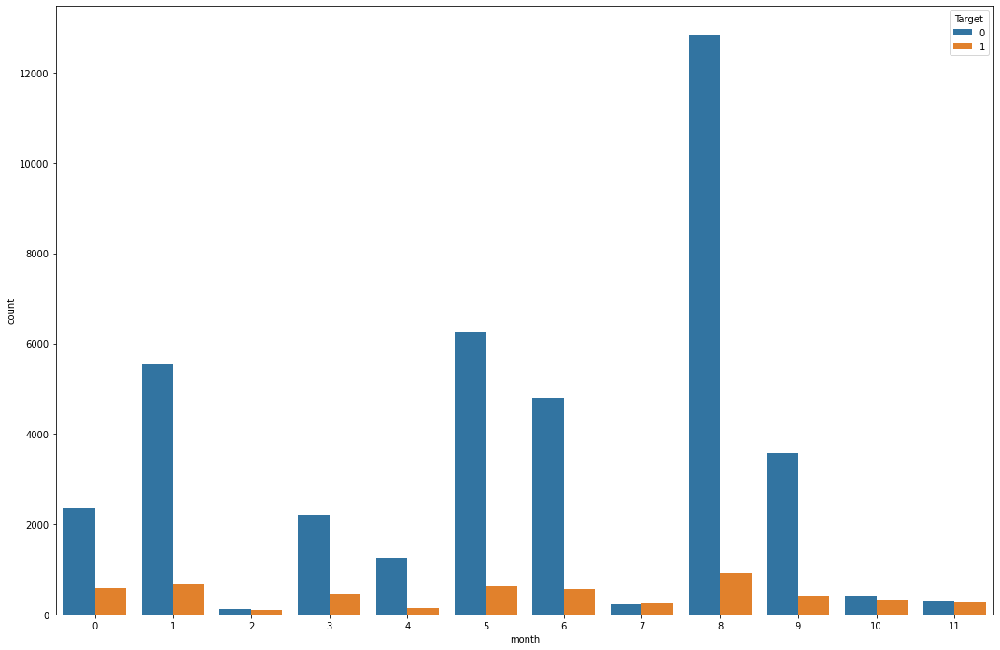

------------------------------------------------------------------------------------------------
Target           0         1
poutcome                    
0         0.873903  0.126097
1         0.833152  0.166848
2         0.352747  0.647253
3         0.908385  0.091615


<Figure size 432x288 with 0 Axes>

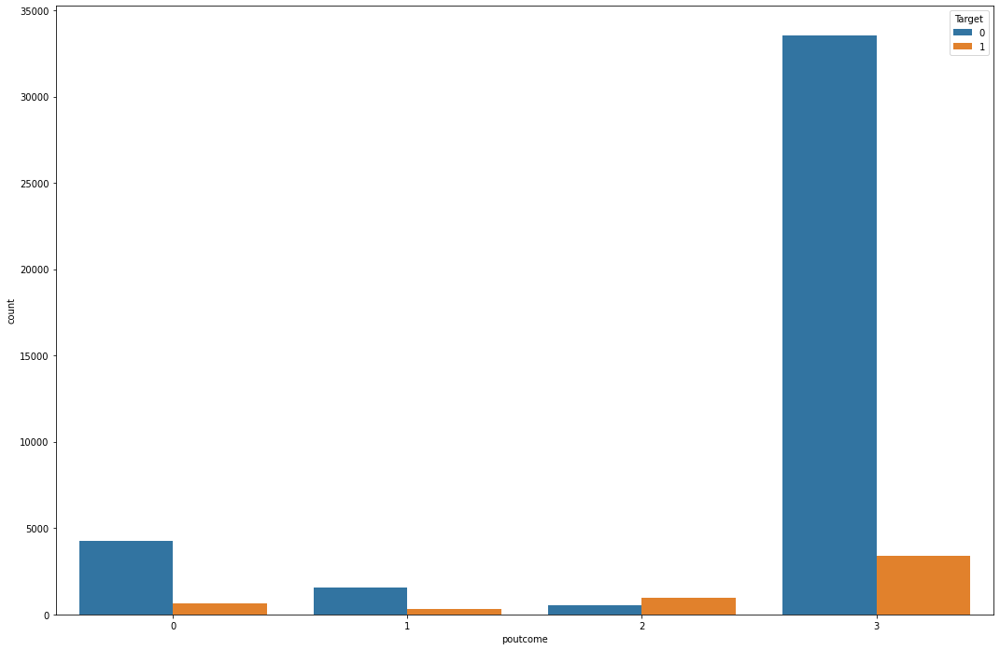

------------------------------------------------------------------------------------------------


<Figure size 432x288 with 0 Axes>

In [27]:
i = 1
for col in cat_cols:
    plt.figure(figsize=(18,12))
    print(pd.crosstab(bank_deposit_df[col],bank_deposit_df['Target'],normalize='index'))
    sns.countplot(x=col, data=bank_deposit_df,hue="Target");
    plt.show()
    plt.tight_layout()
    i = i+1
    print('------------------------------------------------------------------------------------------------')

#### Boolean Independent Variables vs Target Variable

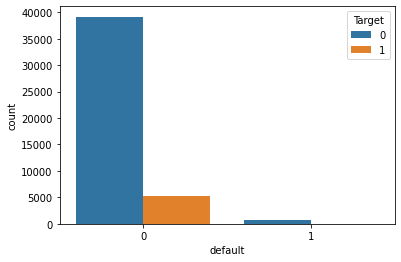

In [28]:
pd.crosstab(bank_deposit_df['default'],bank_deposit_df['Target'],normalize='index')
sns.countplot(x=bank_deposit_df['default'], data=bank_deposit_df,hue="Target");

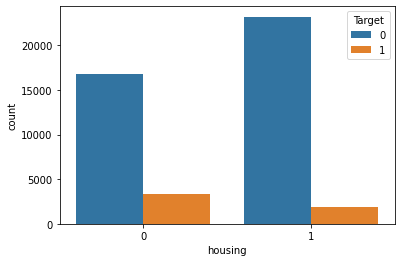

In [29]:
pd.crosstab(bank_deposit_df['housing'],bank_deposit_df['Target'],normalize='index')
sns.countplot(x=bank_deposit_df['housing'], data=bank_deposit_df,hue="Target");

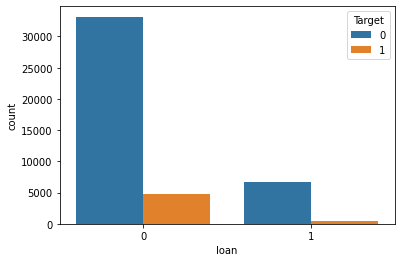

In [30]:
pd.crosstab(bank_deposit_df['loan'],bank_deposit_df['Target'],normalize='index')
sns.countplot(x=bank_deposit_df['loan'], data=bank_deposit_df,hue="Target");

### Multivariate analysis

In [31]:
# Correlation matrix 
corr = bank_deposit_df.corr()
corr

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,Target
age,1.000000,-0.021868,-0.403240,-0.106807,-0.017879,0.097783,-0.185513,-0.015655,0.026221,-0.009120,-0.042357,-0.004648,0.004760,-0.023758,0.001288,0.007367,0.025155
job,-0.021868,1.000000,0.062045,0.166707,-0.006853,0.018232,-0.125363,-0.033004,-0.082063,0.022856,-0.092870,0.004744,0.006839,-0.024455,-0.000911,0.011010,0.040438
marital,-0.403240,0.062045,1.000000,0.108576,-0.007023,0.002122,-0.016096,-0.046893,-0.039201,-0.005261,-0.006991,0.011852,-0.008994,0.019172,0.014973,-0.016850,0.045588
education,-0.106807,0.166707,0.108576,1.000000,-0.010718,0.064514,-0.090790,-0.048574,-0.110928,0.022671,-0.057304,0.001935,0.006255,0.000052,0.017570,-0.019361,0.066241
default,-0.017879,-0.006853,-0.007023,-0.010718,1.000000,-0.066745,-0.006025,0.077234,0.015404,0.009424,0.011486,-0.010021,0.016822,-0.029979,-0.018329,0.034898,-0.022419
balance,0.097783,0.018232,0.002122,0.064514,-0.066745,1.000000,-0.068768,-0.084350,-0.027273,0.004503,0.019777,0.021560,-0.014578,0.003435,0.016674,-0.020967,0.052838
housing,-0.185513,-0.125363,-0.016096,-0.090790,-0.006025,-0.068768,1.000000,0.041323,0.188123,-0.027982,0.271481,0.005075,-0.023599,0.124178,0.037076,-0.099971,-0.139173
loan,-0.015655,-0.033004,-0.046893,-0.048574,0.077234,-0.084350,0.041323,1.000000,-0.010873,0.011370,0.022145,-0.012412,0.009980,-0.022754,-0.011043,0.015458,-0.068185
contact,0.026221,-0.082063,-0.039201,-0.110928,0.015404,-0.027273,0.188123,-0.010873,1.000000,-0.027936,0.361145,-0.020839,0.019614,-0.244816,-0.147811,0.272214,-0.148395
day,-0.009120,0.022856,-0.005261,0.022671,0.009424,0.004503,-0.027982,0.011370,-0.027936,1.000000,-0.006028,-0.030206,0.162490,-0.093044,-0.051710,0.083460,-0.028348


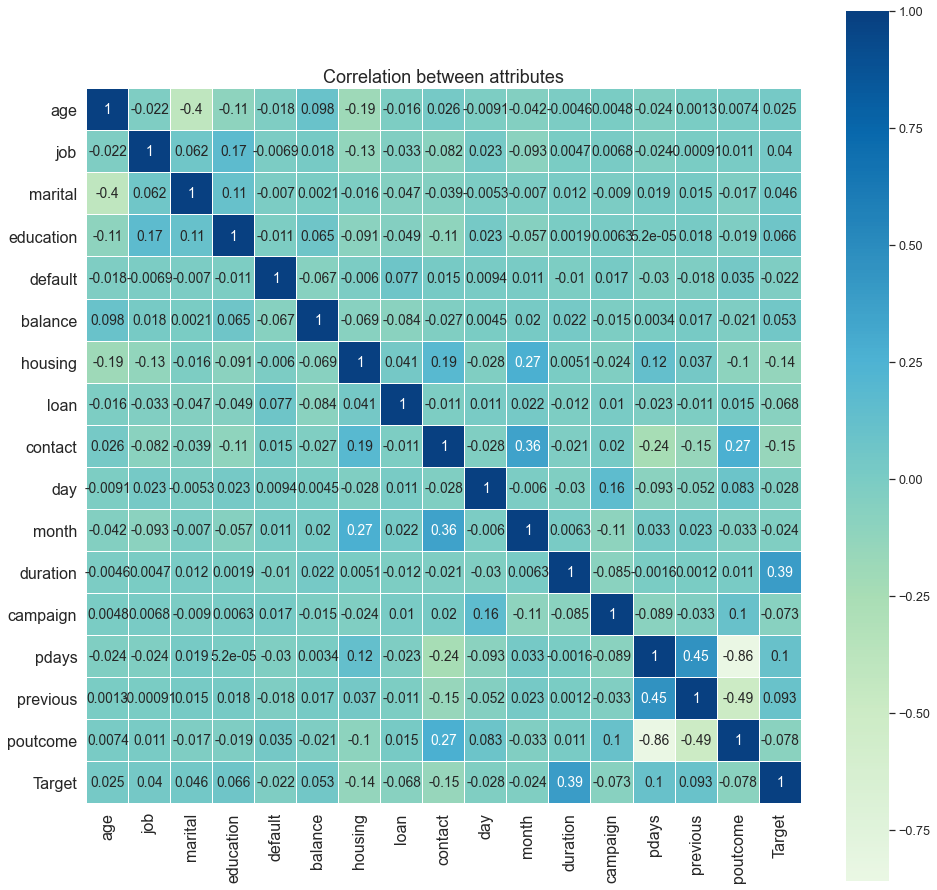

In [34]:
# Heatmap
sns.set(font_scale=1.15)
fig,ax=plt.subplots(figsize=(16,16))
sns.heatmap(corr, cmap='GnBu',annot=True,linewidths=0.01,center=0,linecolor='white',square=True)
plt.title('Correlation between attributes',fontsize=18)
ax.tick_params(labelsize=16)

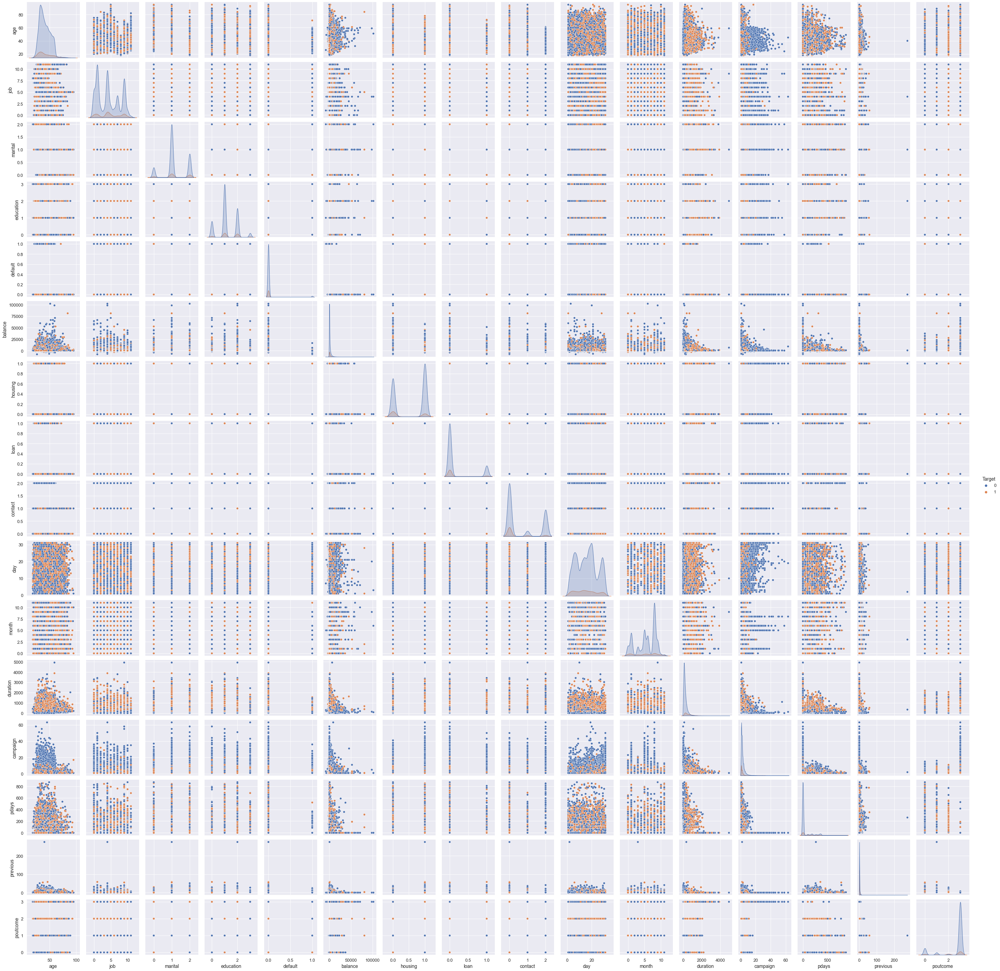

In [35]:
sns.pairplot(data = bank_deposit_df,hue='Target',diag_kind ='kde');

### Model Building (without managing Imbalance in the Target column and Normalizing the columns)

In [36]:
## Define X and Y variables
X = bank_deposit_df.drop('Target', axis=1)
Y = bank_deposit_df[['Target']]

In [37]:
#Convert categorical variables to dummy variables
X = pd.get_dummies(X, drop_first=True)
X

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome
0,58,4,1,2,0,2143,1,0,2,5,8,261,1,-1,0,3
1,44,9,2,1,0,29,1,0,2,5,8,151,1,-1,0,3
2,33,2,1,1,0,2,1,1,2,5,8,76,1,-1,0,3
3,47,1,1,3,0,1506,1,0,2,5,8,92,1,-1,0,3
4,33,11,2,3,0,1,0,0,2,5,8,198,1,-1,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,9,1,2,0,825,0,0,0,17,9,977,3,-1,0,3
45207,71,5,0,0,0,1729,0,0,0,17,9,456,2,-1,0,3
45208,72,5,1,1,0,5715,0,0,0,17,9,1127,5,184,3,2
45209,57,1,1,1,0,668,0,0,1,17,9,508,4,-1,0,3


In [38]:
## Split into training and test set
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.30,random_state=100,stratify=Y)

### Logistic Regression

In [39]:
from sklearn.metrics import confusion_matrix, recall_score, precision_score, f1_score, roc_auc_score,accuracy_score
from sklearn.linear_model import LogisticRegression

logreg = LogisticRegression(random_state=100)
logreg.fit(X_train, y_train)                    # fit the model on train data

LogisticRegression(random_state=100)

In [40]:
y_predict = logreg.predict(X_test)

In [41]:
y_predict

array([0, 0, 0, ..., 0, 0, 0])

[[11754   223]
 [ 1297   290]]


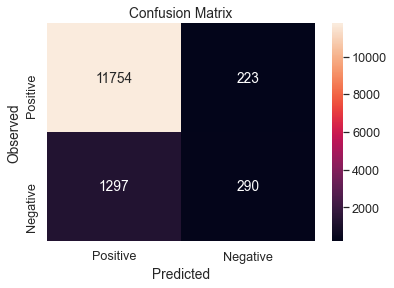

In [42]:
cmatrix = confusion_matrix(y_test, y_predict)
print(cmatrix)
class_label = ["Positive", "Negative"]
bank_cm = pd.DataFrame(cmatrix, index = class_label, columns = class_label)
sns.heatmap(bank_cm, annot = True, fmt = "d")
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Observed")
plt.show()

In [43]:
# Calculate classification report
from sklearn.metrics import classification_report
print(classification_report(y_test, y_predict))

              precision    recall  f1-score   support

           0       0.90      0.98      0.94     11977
           1       0.57      0.18      0.28      1587

    accuracy                           0.89     13564
   macro avg       0.73      0.58      0.61     13564
weighted avg       0.86      0.89      0.86     13564



In [44]:
#Import the metrics
from sklearn import metrics
acc_logreg = metrics.accuracy_score(y_test, y_predict)
print('Accuracy - Logistic Regression : ',acc_logreg)

Accuracy - Logistic Regression :  0.8879386611618991


In [47]:
print("Training accuracy",logreg.score(X_train,y_train))  
print()
print("Testing accuracy",logreg.score(X_test, y_test))
print()
print("Recall:",recall_score(y_test,y_predict,pos_label=1))
print()
print("Precision:",precision_score(y_test,y_predict,pos_label=1))
print()
print("F1 Score:",f1_score(y_test,y_predict,pos_label=1))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Training accuracy 0.8875090845893766

Testing accuracy 0.8879386611618991

Recall: 0.18273471959672338

Precision: 0.5653021442495126

F1 Score: 0.2761904761904762

Roc Auc Score: 0.5820578499043984


In [49]:
#Store the accuracy results for each model in a dataframe for final comparison

results_df = pd.DataFrame({'Method':['Logistic Regression'],'Accuracy': acc_logreg.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582


### Decision Tree

In [50]:
# Invoking the decision tree classifier function, using 'entropy' method of finding the split columns. 

from sklearn.tree import DecisionTreeClassifier
dtree = DecisionTreeClassifier(criterion='entropy',random_state=100)

In [51]:
dtree.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', random_state=100)

In [52]:
dtree.score(X_train, y_train)

1.0

In [53]:
dtree.score(X_test, y_test)

0.8765113535830139

In [54]:
#Making the prediction
y_predict = dtree.predict(X_test)

In [56]:
# Evaluate the model using accuracy, confusion metrix, and classification report
acc_DT = metrics.accuracy_score(y_test, y_predict)
print('Accuracy DT: ',acc_DT)
print()
print('Confusion Matrix DT: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report DT: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy DT:  0.8765113535830139

Confusion Matrix DT: 
 [[11122   855]
 [  820   767]]

Classification report DT: 
               precision    recall  f1-score   support

           0       0.93      0.93      0.93     11977
           1       0.47      0.48      0.48      1587

    accuracy                           0.88     13564
   macro avg       0.70      0.71      0.70     13564
weighted avg       0.88      0.88      0.88     13564


Roc Auc Score: 0.7059575012998818


In [58]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Decision Tree'], 'Accuracy': acc_DT.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706


In [59]:
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image  
import pydotplus
import graphviz

bank_df = bank_deposit_df.copy()
feature_cols = X.columns

In [60]:
dot_data = StringIO()
export_graphviz(dtree, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('bank_data.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.316672 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.316672 to fit



In [61]:
print (pd.DataFrame(dtree.feature_importances_, columns = ["Imp"], index = X_train.columns))

                Imp
age        0.089319
job        0.036712
marital    0.016969
education  0.021231
default    0.000901
balance    0.115666
housing    0.025621
loan       0.008609
contact    0.037570
day        0.083116
month      0.089695
duration   0.306504
campaign   0.028469
pdays      0.077578
previous   0.014312
poutcome   0.047728


In [62]:
# Regularizing the Decision tree classifier and fitting the model
reg_dtree = DecisionTreeClassifier(criterion = 'entropy', random_state = 100,max_depth = 7,min_samples_leaf=5)
reg_dtree.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=7, min_samples_leaf=5,
                       random_state=100)

In [63]:
y_predict = reg_dtree.predict(X_test)

In [64]:
# performance on train data
print('Performance on Training data using  Pruned DT: ',reg_dtree.score(X_train , y_train))
# performance on test data
print('Performance on Testing data using  Pruned DT: ',reg_dtree.score(X_test , y_test))

Performance on Training data using  Pruned DT:  0.9085537333712517
Performance on Testing data using  Pruned DT:  0.9031259215570628


In [65]:
# Evaluate the model using accuracy, confusion metrix, and classification report

acc_pruned_DT=metrics.accuracy_score(y_test, y_predict)
print("Accuracy Pruned DT:",acc_pruned_DT)
print()
print('Confusion Matrix Pruned DT: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report Pruned DT: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy Pruned DT: 0.9031259215570628

Confusion Matrix Pruned DT: 
 [[11602   375]
 [  939   648]]

Classification report Pruned DT: 
               precision    recall  f1-score   support

           0       0.93      0.97      0.95     11977
           1       0.63      0.41      0.50      1587

    accuracy                           0.90     13564
   macro avg       0.78      0.69      0.72     13564
weighted avg       0.89      0.90      0.89     13564


Roc Auc Score: 0.6885037847430637


In [66]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Decision Tree with Pruning'], 'Accuracy': acc_pruned_DT.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689


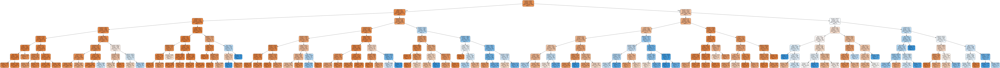

In [68]:
dot_data = StringIO()
export_graphviz(reg_dtree, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['1','0'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('bank_data_pruned.png')
Image(graph.create_png())

### Random Forest 

In [69]:
from sklearn.ensemble import RandomForestClassifier

rforest = RandomForestClassifier(n_estimators = 50,random_state=100)
rforest = rforest.fit(X_train, y_train)

In [71]:
y_predict = rforest.predict(X_test)
acc_RF = metrics.accuracy_score(y_test , y_predict)
print('Accuracy using Random forest: ',acc_RF)
print()
print('Confusion Matrix for Random Forest: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for Random Forest: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using Random forest:  0.9049690356826895

Confusion Matrix for Random Forest: 
 [[11624   353]
 [  936   651]]

Classification report for Random Forest: 
               precision    recall  f1-score   support

           0       0.93      0.97      0.95     11977
           1       0.65      0.41      0.50      1587

    accuracy                           0.90     13564
   macro avg       0.79      0.69      0.72     13564
weighted avg       0.89      0.90      0.90     13564


Roc Auc Score: 0.6903673913122395


In [72]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Random Forest'], 'Accuracy': acc_RF.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690


In [73]:
reg_rforest = RandomForestClassifier(criterion = 'entropy', random_state = 100,max_depth = 7,min_samples_leaf=5)
reg_rforest = reg_rforest.fit(X_train, y_train)
y_predict = reg_rforest.predict(X_test)
acc_pruned_RF = metrics.accuracy_score(y_test , y_predict)
print('Accuracy using Random forest pruned: ',acc_pruned_RF)
print()
print('Confusion Matrix Random Forest pruned: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for Random Forest pruned: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using Random forest pruned:  0.8958271896195813

Confusion Matrix Random Forest pruned: 
 [[11880    97]
 [ 1316   271]]

Classification report for Random Forest pruned: 
               precision    recall  f1-score   support

           0       0.90      0.99      0.94     11977
           1       0.74      0.17      0.28      1587

    accuracy                           0.90     13564
   macro avg       0.82      0.58      0.61     13564
weighted avg       0.88      0.90      0.87     13564


Roc Auc Score: 0.5813317943617937


In [74]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Random Forest with Pruning'], 'Accuracy': acc_pruned_RF.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581


### Bagging

In [75]:
from sklearn.ensemble import BaggingClassifier

bag = BaggingClassifier(base_estimator=dtree,n_estimators=50,random_state=100)
bag = bag.fit(X_train, y_train)

In [76]:
y_predict = bag.predict(X_test)
acc_BG = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using Bagging: ',acc_BG)
print()
print('Confusion Matrix using Bagging: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for Bagging: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using Bagging:  0.9028310232969625

Confusion Matrix using Bagging: 
 [[11533   444]
 [  874   713]]

Classification report for Bagging: 
               precision    recall  f1-score   support

           0       0.93      0.96      0.95     11977
           1       0.62      0.45      0.52      1587

    accuracy                           0.90     13564
   macro avg       0.77      0.71      0.73     13564
weighted avg       0.89      0.90      0.90     13564


Roc Auc Score: 0.7061021547337711


In [77]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Bagging'], 'Accuracy': acc_BG.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706


### Ada Boost

In [78]:
from sklearn.ensemble import AdaBoostClassifier

aboost = AdaBoostClassifier(base_estimator=dtree, n_estimators=50,random_state=100)
aboost = aboost.fit(X_train, y_train)

In [79]:
y_predict = aboost.predict(X_test)
acc_AB = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using AdaBoost: ',acc_AB)
print()
print('Confusion Matrix using AdaBoost: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for AdaBoost: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using AdaBoost:  0.8762164553229136

Confusion Matrix using AdaBoost: 
 [[11126   851]
 [  828   759]]

Classification report for AdaBoost: 
               precision    recall  f1-score   support

           0       0.93      0.93      0.93     11977
           1       0.47      0.48      0.47      1587

    accuracy                           0.88     13564
   macro avg       0.70      0.70      0.70     13564
weighted avg       0.88      0.88      0.88     13564


Roc Auc Score: 0.7036040091334478


In [80]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Ada Boost'], 'Accuracy': acc_AB.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704


### Gradient Boost

In [81]:
from sklearn.ensemble import GradientBoostingClassifier

gboost = GradientBoostingClassifier(n_estimators=50,random_state=100)
gboost = gboost.fit(X_train, y_train)

In [82]:
y_predict = gboost.predict(X_test)
acc_GB = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using GradientBoost: ',acc_GB)
print()
print('Confusion Matrix using GradientBoost: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for GradientBoost: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using GradientBoost:  0.9012828074314362

Confusion Matrix using GradientBoost: 
 [[11701   276]
 [ 1063   524]]

Classification report for GradientBoost: 
               precision    recall  f1-score   support

           0       0.92      0.98      0.95     11977
           1       0.66      0.33      0.44      1587

    accuracy                           0.90     13564
   macro avg       0.79      0.65      0.69     13564
weighted avg       0.89      0.90      0.89     13564


Roc Auc Score: 0.6535692833654758


In [83]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Gradient Boost'], 'Accuracy': acc_GB.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654


### XGBoost

In [84]:
import xgboost as xgb
from xgboost import XGBClassifier

xgboost = XGBClassifier(n_estimators=50,random_state=100)
xgboost.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=50, n_jobs=0, num_parallel_tree=1, random_state=100,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [85]:
y_predict = xgboost.predict(X_test)
acc_XGB = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using XGBoost: ',acc_XGB)
print()
print('Confusion Matrix using XGBoost: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for XGBoost: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using XGBoost:  0.9080654674137423

Confusion Matrix using XGBoost: 
 [[11593   384]
 [  863   724]]

Classification report for XGBoost: 
               precision    recall  f1-score   support

           0       0.93      0.97      0.95     11977
           1       0.65      0.46      0.54      1587

    accuracy                           0.91     13564
   macro avg       0.79      0.71      0.74     13564
weighted avg       0.90      0.91      0.90     13564


Roc Auc Score: 0.7120726140772123


In [86]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['XG Boost'], 'Accuracy': acc_XGB.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712


### Light GBM

In [87]:
import lightgbm
from lightgbm import LGBMClassifier

lt_gbm = LGBMClassifier(n_estimators=50,random_state=100)
lt_gbm.fit(X_train, y_train)

LGBMClassifier(n_estimators=50, random_state=100)

In [88]:
y_predict = lt_gbm.predict(X_test)
acc_LGB = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using LightGBM: ',acc_LGB)
print()
print('Confusion Matrix using LightGBM: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for LightGBM: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using LightGBM:  0.9100560306694191

Confusion Matrix using LightGBM: 
 [[11618   359]
 [  861   726]]

Classification report for LightGBM: 
               precision    recall  f1-score   support

           0       0.93      0.97      0.95     11977
           1       0.67      0.46      0.54      1587

    accuracy                           0.91     13564
   macro avg       0.80      0.71      0.75     13564
weighted avg       0.90      0.91      0.90     13564


Roc Auc Score: 0.7137464008284309


In [89]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Light GBM'], 'Accuracy': acc_LGB.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


### Model Building (with managing Imbalance in the Target column and Normalizing the columns)

In [90]:
bank_new_df = bank_deposit_df.copy()
X = bank_new_df.drop('Target', axis=1)
Y = bank_new_df[['Target']]

In [91]:
#Convert categorical variables to dummy variables
X = pd.get_dummies(X, drop_first=True)
X

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome
0,58,4,1,2,0,2143,1,0,2,5,8,261,1,-1,0,3
1,44,9,2,1,0,29,1,0,2,5,8,151,1,-1,0,3
2,33,2,1,1,0,2,1,1,2,5,8,76,1,-1,0,3
3,47,1,1,3,0,1506,1,0,2,5,8,92,1,-1,0,3
4,33,11,2,3,0,1,0,0,2,5,8,198,1,-1,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,9,1,2,0,825,0,0,0,17,9,977,3,-1,0,3
45207,71,5,0,0,0,1729,0,0,0,17,9,456,2,-1,0,3
45208,72,5,1,1,0,5715,0,0,0,17,9,1127,5,184,3,2
45209,57,1,1,1,0,668,0,0,1,17,9,508,4,-1,0,3


In [92]:
## Split into training and test set
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.30,random_state=100,stratify=Y)

#### Normalizing the columns

In [93]:
from sklearn.preprocessing import StandardScaler

scaler=StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [94]:
# summarize class distribution
bank_new_df["Target"].value_counts()

0    39922
1     5289
Name: Target, dtype: int64

In [95]:
print(X_train.shape)
print(y_train.shape)

(31647, 16)
(31647, 1)


#### Oversample imbalanced target attribute with SMOTE

In [96]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

# transform the column
oversample = SMOTE()
undersample = RandomUnderSampler()
steps = [('over', oversample), ('under', undersample)]
pipeline = Pipeline(steps=steps)
X_train, y_train = pipeline.fit_resample(X_train, y_train)

In [97]:
# summarize the new class distribution

print(X_train.shape)
print(y_train.shape)

(55890, 16)
(55890, 1)


### Logistic Regression

In [98]:
logreg_new = LogisticRegression(random_state=100)
logreg_new.fit(X_train, y_train)                    # fit the model on train data

LogisticRegression(random_state=100)

In [99]:
y_predict = logreg_new.predict(X_test)

In [100]:
y_predict

array([0, 0, 0, ..., 0, 0, 0])

[[9776 2201]
 [ 341 1246]]


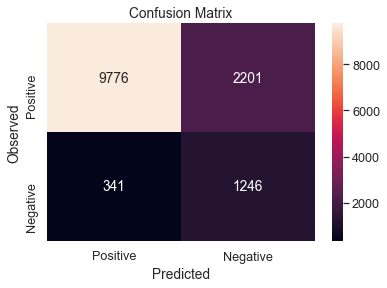

In [101]:
cmatrix = confusion_matrix(y_test, y_predict)
print(cmatrix)
class_label = ["Positive", "Negative"]
bank_cm = pd.DataFrame(cmatrix, index = class_label, columns = class_label)
sns.heatmap(bank_cm, annot = True, fmt = "d")
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Observed")
plt.show()

In [102]:
# Calculate classification report
from sklearn.metrics import classification_report

acc_logreg_new = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using Logistic Regression: ',acc_logreg_new)
print(classification_report(y_test, y_predict))

Accuracy using Logistic Regression:  0.8125921557062813
              precision    recall  f1-score   support

           0       0.97      0.82      0.88     11977
           1       0.36      0.79      0.50      1587

    accuracy                           0.81     13564
   macro avg       0.66      0.80      0.69     13564
weighted avg       0.90      0.81      0.84     13564



In [104]:
print("Training accuracy",logreg_new.score(X_train,y_train))  
print()
print("Testing accuracy",logreg_new.score(X_test, y_test))
print()
print("Recall:",recall_score(y_test,y_predict,pos_label=1))
print()
print("Precision:",precision_score(y_test,y_predict,pos_label=1))
print()
print("F1 Score:",f1_score(y_test,y_predict,pos_label=1))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Training accuracy 0.8149042762569333

Testing accuracy 0.8125921557062813

Recall: 0.7851291745431632

Precision: 0.3614737452857557

F1 Score: 0.4950337703615415

Roc Auc Score: 0.8006801420849741


In [105]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Logistic Regression with Oversampling'], 'Accuracy': acc_logreg_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


In [106]:
# Create the GridSearch estimator along with a parameter object containing the values to adjust
from sklearn.model_selection import GridSearchCV

param_grid = [
  {'penalty': ['l1'], 'solver': [ 'liblinear','saga']},
  {'penalty': ['l2','none'], 'solver': ['newton-cg','lbfgs','sag','saga']},
  {'C': [1000, 100, 10, 1.0, 0.1, 0.01, 0.001]},
  {'class_weight': [None,'balanced']}
 ]

In [107]:
# Create grid search using 5-fold cross validation
clf = GridSearchCV(logreg_new, param_grid, cv=5, n_jobs = -1,verbose=2)

In [108]:
# Fit grid search
best_model = clf.fit(X_train, y_train)

Fitting 5 folds for each of 19 candidates, totalling 95 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   11.0s
[Parallel(n_jobs=-1)]: Done  95 out of  95 | elapsed:   14.2s finished


In [109]:
# View best hyperparameters
print('Best C:', best_model.best_estimator_.get_params()['C'])
print('Best Hyper Parameters are: ', best_model.best_params_)

Best C: 1.0
Best Hyper Parameters are:  {'penalty': 'l1', 'solver': 'liblinear'}


In [110]:
# Predict target vector
best_model.predict(X)

array([1, 1, 1, ..., 1, 1, 1])

In [111]:
acc_logreg_hyper = metrics.accuracy_score(y_test, y_predict)
print('Accuracy - Logistic Regression with Oversampling & HyperTuning : ',acc_logreg_hyper)

Accuracy - Logistic Regression with Oversampling & HyperTuning :  0.8125921557062813


In [112]:
#Therefore final model is
y_predict = best_model.predict(X_test)
print("Training accuracy",best_model.score(X_train,y_train))  
print()
print("Testing accuracy",best_model.score(X_test, y_test))
print()
print("Recall:",recall_score(y_test,y_predict,pos_label=1))
print()
print("Precision:",precision_score(y_test,y_predict,pos_label=1))
print()
print("F1 Score:",f1_score(y_test,y_predict,pos_label=1))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Training accuracy 0.8149937376990517

Testing accuracy 0.8124447065762312

Recall: 0.7851291745431632

Precision: 0.3612641345317483

F1 Score: 0.49483717235901503

Roc Auc Score: 0.8005966487226963


In [113]:
conf_matrix = confusion_matrix(y_test, y_predict)
print(conf_matrix)

[[9774 2203]
 [ 341 1246]]


In [114]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Logistic Regression with Oversampling & HyperTuning'], 'Accuracy': acc_logreg_hyper.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


### Decision Tree

In [115]:
# Invoking the decision tree classifier function, using 'entropy' method of finding the split columns. 

dtree_new = DecisionTreeClassifier(criterion='entropy',random_state=100)

In [116]:
dtree_new.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', random_state=100)

In [117]:
dtree_new.score(X_train, y_train)

1.0

In [118]:
dtree_new.score(X_test, y_test)

0.8670746092598054

In [119]:
#Making the prediction
y_predict = dtree_new.predict(X_test)

In [120]:
# Evaluate the model using accuracy, confusion metrix, and classification report

acc_DT_new = metrics.accuracy_score(y_test, y_predict)
print('Accuracy DT: ',acc_DT_new)
print()
print('Confusion Matrix DT: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report DT: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy DT:  0.8670746092598054

Confusion Matrix DT: 
 [[10950  1027]
 [  776   811]]

Classification report DT: 
               precision    recall  f1-score   support

           0       0.93      0.91      0.92     11977
           1       0.44      0.51      0.47      1587

    accuracy                           0.87     13564
   macro avg       0.69      0.71      0.70     13564
weighted avg       0.88      0.87      0.87     13564


Roc Auc Score: 0.7126397060444407


In [121]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Decision Tree with Oversampling'], 'Accuracy': acc_DT_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


In [122]:
# Regularizing the Decision tree classifier and fitting the model

reg_dtree_new = DecisionTreeClassifier(criterion = 'entropy', random_state = 100,max_depth = 7,min_samples_leaf=5)
reg_dtree_new.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=7, min_samples_leaf=5,
                       random_state=100)

In [123]:
y_predict = reg_dtree_new.predict(X_test)

In [124]:
# performance on train data
print('Performance on Training data using  Pruned DT: ',reg_dtree_new.score(X_train , y_train))
# performance on test data
print('Performance on Testing data using  Pruned DT: ',reg_dtree_new.score(X_test , y_test))

Performance on Training data using  Pruned DT:  0.8494185006262301
Performance on Testing data using  Pruned DT:  0.798879386611619


In [125]:
# Evaluate the model using accuracy, confusion metrix, and classification report

acc_pruned_DT_new = metrics.accuracy_score(y_test, y_predict)
print("Accuracy Pruned DT:",acc_pruned_DT_new)
print()
print('Confusion Matrix Pruned DT: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report Pruned DT: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy Pruned DT: 0.798879386611619

Confusion Matrix Pruned DT: 
 [[9566 2411]
 [ 317 1270]]

Classification report Pruned DT: 
               precision    recall  f1-score   support

           0       0.97      0.80      0.88     11977
           1       0.35      0.80      0.48      1587

    accuracy                           0.80     13564
   macro avg       0.66      0.80      0.68     13564
weighted avg       0.90      0.80      0.83     13564


Roc Auc Score: 0.7994747757187834


In [126]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Decision Tree with Pruning & Oversampling'], 'Accuracy': acc_pruned_DT_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


In [127]:
# Create the GridSearch estimator along with a parameter object containing the values to adjust

criterion = ['gini', 'entropy']
max_depth = [2,4,6,7,8,10]
sample_split_range = list(range(1, 50))
param_grid = [
  {'criterion': criterion},
  {'max_depth': max_depth},
  {'min_samples_split': sample_split_range}
 ]

In [128]:
# Create grid search using 5-fold cross validation
clf = GridSearchCV(dtree_new, param_grid, cv=5, n_jobs = -1,verbose=2)

In [129]:
# Fit grid search
best_model = clf.fit(X_train, y_train)

Fitting 5 folds for each of 57 candidates, totalling 285 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:   23.9s
[Parallel(n_jobs=-1)]: Done 285 out of 285 | elapsed:   46.3s finished


In [130]:
# View best hyperparameters
print(best_model.best_score_)

print(best_model.best_params_)

# Actual model object fit with those best parameters
# Shows default parameters that we did not specify
print(best_model.best_estimator_)

0.9123098944354983
{'criterion': 'entropy'}
DecisionTreeClassifier(criterion='entropy', random_state=100)


In [131]:
# Predict target vector
best_model.predict(X)

array([0, 0, 0, ..., 0, 0, 0])

In [133]:
# Therefore final model is
y_predict = best_model.predict(X_test)
acc_DT_tu = metrics.accuracy_score(y_test , y_predict)
print("Training accuracy",best_model.score(X_train,y_train))  
print()
print("Testing accuracy",best_model.score(X_test, y_test))
print()
print("Recall:",recall_score(y_test,y_predict,pos_label=1))
print()
print("Precision:",precision_score(y_test,y_predict,pos_label=1))
print()
print("F1 Score:",f1_score(y_test,y_predict,pos_label=1))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Training accuracy 1.0

Testing accuracy 0.8670746092598054

Recall: 0.5110270951480781

Precision: 0.44124047878128403

F1 Score: 0.4735766423357664

Roc Auc Score: 0.7126397060444407


In [134]:
conf_matrix = confusion_matrix(y_test, y_predict)
print(conf_matrix)

[[10950  1027]
 [  776   811]]


In [135]:
print('Classification report for Decision Tree with Oversampling & HyperTuning: \n',metrics.classification_report(y_test, y_predict))

Classification report for Decision Tree with Oversampling & HyperTuning: 
               precision    recall  f1-score   support

           0       0.93      0.91      0.92     11977
           1       0.44      0.51      0.47      1587

    accuracy                           0.87     13564
   macro avg       0.69      0.71      0.70     13564
weighted avg       0.88      0.87      0.87     13564



In [136]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Decision Tree with Oversampling & HyperTuning'], 'Accuracy': acc_DT_tu.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.211001 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.211001 to fit



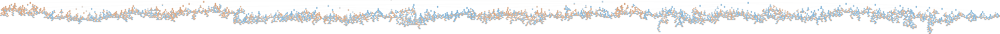

In [137]:
dot_data = StringIO()
export_graphviz(dtree_new, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('bank_data_tuned.png')
Image(graph.create_png())

### Random Forest

In [138]:
rforest_new = RandomForestClassifier(n_estimators = 50,random_state=100)
rforest_new = rforest_new.fit(X_train, y_train)

In [139]:
y_predict = rforest_new.predict(X_test)
acc_RF_new = metrics.accuracy_score(y_test , y_predict)
print('Accuracy using Random forest: ',acc_RF_new)
print()
print('Confusion Matrix for Random Forest: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for Random Forest: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using Random forest:  0.8977440283102329

Confusion Matrix for Random Forest: 
 [[11230   747]
 [  640   947]]

Classification report for Random Forest: 
               precision    recall  f1-score   support

           0       0.95      0.94      0.94     11977
           1       0.56      0.60      0.58      1587

    accuracy                           0.90     13564
   macro avg       0.75      0.77      0.76     13564
weighted avg       0.90      0.90      0.90     13564


Roc Auc Score: 0.7671769179101363


In [140]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Random Forest with Oversampling'], 'Accuracy': acc_RF_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


In [141]:
reg_rforest_new = RandomForestClassifier(criterion = 'entropy', random_state = 100,max_depth = 7,min_samples_leaf=5)
reg_rforest_new = reg_rforest_new.fit(X_train, y_train)
y_predict = reg_rforest_new.predict(X_test)
acc_pruned_RF_new = metrics.accuracy_score(y_test , y_predict)
print('Accuracy using Random forest pruned: ',acc_pruned_RF_new)
print()
print('Confusion Matrix Random Forest pruned: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for Random Forest pruned: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using Random forest pruned:  0.8364789147744028

Confusion Matrix Random Forest pruned: 
 [[10067  1910]
 [  308  1279]]

Classification report for Random Forest pruned: 
               precision    recall  f1-score   support

           0       0.97      0.84      0.90     11977
           1       0.40      0.81      0.54      1587

    accuracy                           0.84     13564
   macro avg       0.69      0.82      0.72     13564
weighted avg       0.90      0.84      0.86     13564


Roc Auc Score: 0.82322540172171


In [142]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Random Forest with Pruning & Oversampling'], 'Accuracy': acc_pruned_RF_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


In [146]:
# Create the GridSearch estimator along with a parameter object containing the values to adjust

n_estimators = [100, 200, 300, 500]
max_features = ['sqrt']
max_depth = [5,6,7,8]
min_samples_split = [2, 5, 10,15]
min_samples_leaf = [1, 2, 5, 10] 

param_grid = dict(n_estimators = n_estimators, max_depth = max_depth,  
              min_samples_split = min_samples_split, max_features = max_features,
             min_samples_leaf = min_samples_leaf)

In [147]:
# Create grid search using 5-fold cross validation
clf = GridSearchCV(rforest_new, param_grid, cv=5, n_jobs = -1,verbose=2)

In [148]:
# Fit grid search
best_model = clf.fit(X_train, y_train)

Fitting 5 folds for each of 256 candidates, totalling 1280 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:  9.3min
[Parallel(n_jobs=-1)]: Done 357 tasks      | elapsed: 21.8min
[Parallel(n_jobs=-1)]: Done 640 tasks      | elapsed: 41.3min
[Parallel(n_jobs=-1)]: Done 1005 tasks      | elapsed: 73.4min
[Parallel(n_jobs=-1)]: Done 1280 out of 1280 | elapsed: 97.0min finished


In [149]:
# View best hyperparameters
print(best_model.best_score_)

print(best_model.best_params_)

# Actual model object fit with those best parameters
# Shows default parameters that we did not specify
print(best_model.best_estimator_)

0.8909465020576132
{'max_depth': 8, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}
RandomForestClassifier(max_depth=8, max_features='sqrt', min_samples_leaf=2,
                       min_samples_split=5, n_estimators=200, random_state=100)


In [150]:
# Predict target vector
best_model.predict(X)

array([1, 1, 1, ..., 1, 1, 1])

In [151]:
# Therefore final model is
y_predict = best_model.predict(X_test)
acc_RF_tu = metrics.accuracy_score(y_test , y_predict)
print("Training accuracy",best_model.score(X_train,y_train))  
print()
print("Testing accuracy",best_model.score(X_test, y_test))
print()
print("Recall:",recall_score(y_test,y_predict,pos_label=1))
print()
print("Precision:",precision_score(y_test,y_predict,pos_label=1))
print()
print("F1 Score:",f1_score(y_test,y_predict,pos_label=1))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Training accuracy 0.8973877258901414

Testing accuracy 0.8459156590976113

Recall: 0.7958412098298677

Precision: 0.41696929679762296

F1 Score: 0.5472270363951472

Roc Auc Score: 0.8241959660237257


In [152]:
conf_matrix = confusion_matrix(y_test, y_predict)
print(conf_matrix)

[[10211  1766]
 [  324  1263]]


In [153]:
print('Classification report for Random Forest with Oversampling & HyperTuning: \n',metrics.classification_report(y_test, y_predict))

Classification report for Random Forest with Oversampling & HyperTuning: 
               precision    recall  f1-score   support

           0       0.97      0.85      0.91     11977
           1       0.42      0.80      0.55      1587

    accuracy                           0.85     13564
   macro avg       0.69      0.82      0.73     13564
weighted avg       0.90      0.85      0.87     13564



In [154]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Random Forest with Oversampling & HyperTuning'], 'Accuracy': acc_RF_tu.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


### Bagging

In [155]:
bag_new = BaggingClassifier(base_estimator=dtree_new,n_estimators=50,random_state=100)
bag_new = bag_new.fit(X_train, y_train)

In [156]:
y_predict = bag_new.predict(X_test)
acc_BG_new = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using Bagging: ',acc_BG_new)
print()
print('Confusion Matrix using Bagging: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for Bagging: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using Bagging:  0.8947213211442052

Confusion Matrix using Bagging: 
 [[11152   825]
 [  603   984]]

Classification report for Bagging: 
               precision    recall  f1-score   support

           0       0.95      0.93      0.94     11977
           1       0.54      0.62      0.58      1587

    accuracy                           0.89     13564
   macro avg       0.75      0.78      0.76     13564
weighted avg       0.90      0.89      0.90     13564


Roc Auc Score: 0.7755778916521316


In [157]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Bagging with Oversampling'], 'Accuracy': acc_BG_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


### Ada Boost

In [158]:
aboost_new = AdaBoostClassifier(base_estimator=dtree_new, n_estimators=50,random_state=100)
aboost_new = aboost_new.fit(X_train, y_train)

In [159]:
y_predict = aboost_new.predict(X_test)
acc_AB_new = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using AdaBoost: ',acc_AB_new)
print()
print('Confusion Matrix using AdaBoost: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for AdaBoost: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using AdaBoost:  0.867885579475081

Confusion Matrix using AdaBoost: 
 [[10933  1044]
 [  748   839]]

Classification report for AdaBoost: 
               precision    recall  f1-score   support

           0       0.94      0.91      0.92     11977
           1       0.45      0.53      0.48      1587

    accuracy                           0.87     13564
   macro avg       0.69      0.72      0.70     13564
weighted avg       0.88      0.87      0.87     13564


Roc Auc Score: 0.7207516885835427


In [160]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Ada Boost with Oversampling'], 'Accuracy': acc_AB_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


In [161]:
# Create the GridSearch estimator along with a parameter object containing the values to adjust

n_estimators = [10,100, 200, 300, 500]
learning_rate = [0.001,0.05,0.01,0.1]
param_grid = dict(n_estimators = n_estimators, learning_rate = learning_rate)

In [162]:
# Create grid search using 5-fold cross validation
clf = GridSearchCV(aboost_new, param_grid, cv=5, n_jobs = -1,verbose=2)

In [163]:
# Fit grid search
best_model = clf.fit(X_train, y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:    8.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   20.0s finished


In [164]:
# View best hyperparameters
print(best_model.best_score_)

print(best_model.best_params_)

# Actual model object fit with those best parameters
# Shows default parameters that we did not specify
print(best_model.best_estimator_)

0.9121130792628376
{'learning_rate': 0.001, 'n_estimators': 10}
AdaBoostClassifier(base_estimator=DecisionTreeClassifier(criterion='entropy',
                                                         random_state=100),
                   learning_rate=0.001, n_estimators=10, random_state=100)


In [165]:
# Predict target vector
best_model.predict(X)

array([0, 0, 0, ..., 0, 0, 0])

In [166]:
# Therefore final model is
y_predict = best_model.predict(X_test)
acc_AB_tu = metrics.accuracy_score(y_test , y_predict)
print("Training accuracy",best_model.score(X_train,y_train))  
print()
print("Testing accuracy",best_model.score(X_test, y_test))
print()
print("Recall:",recall_score(y_test,y_predict,pos_label=1))
print()
print("Precision:",precision_score(y_test,y_predict,pos_label=1))
print()
print("F1 Score:",f1_score(y_test,y_predict,pos_label=1))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Training accuracy 1.0

Testing accuracy 0.867885579475081

Recall: 0.5286704473850031

Precision: 0.44556558682952735

F1 Score: 0.48357348703170033

Roc Auc Score: 0.7207516885835427


In [167]:
conf_matrix = confusion_matrix(y_test, y_predict)
print(conf_matrix)

[[10933  1044]
 [  748   839]]


In [168]:
print('Classification report for Adaboost with Oversampling & HyperTuning: \n',metrics.classification_report(y_test, y_predict))

Classification report for Adaboost with Oversampling & HyperTuning: 
               precision    recall  f1-score   support

           0       0.94      0.91      0.92     11977
           1       0.45      0.53      0.48      1587

    accuracy                           0.87     13564
   macro avg       0.69      0.72      0.70     13564
weighted avg       0.88      0.87      0.87     13564



In [169]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Adaboost with Oversampling & HyperTuning'], 'Accuracy': acc_AB_tu.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


### Gradient Boost

In [170]:
gboost_new = GradientBoostingClassifier(n_estimators=50,random_state=100)
gboost_new = gboost_new.fit(X_train, y_train)

In [171]:
y_predict = gboost_new.predict(X_test)
acc_GB_new = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using GradientBoost: ',acc_GB_new)
print()
print('Confusion Matrix using GradientBoost: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for GradientBoost: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using GradientBoost:  0.8531406664700678

Confusion Matrix using GradientBoost: 
 [[10338  1639]
 [  353  1234]]

Classification report for GradientBoost: 
               precision    recall  f1-score   support

           0       0.97      0.86      0.91     11977
           1       0.43      0.78      0.55      1587

    accuracy                           0.85     13564
   macro avg       0.70      0.82      0.73     13564
weighted avg       0.90      0.85      0.87     13564


Roc Auc Score: 0.8203610585485234


In [172]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Gradient Boost with Oversampling'], 'Accuracy': acc_GB_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


In [ ]:
# Create the GridSearch estimator along with a parameter object containing the values to adjust

n_estimators = [100,200, 300, 400, 500]
learning_rate = [0.001,0.05,0.01,0.1]
max_depth = [5,6,8,10]
subsample = [0.5, 0.6, 0.8, 0.9, 1.0]

param_grid = dict(n_estimators = n_estimators, max_depth = max_depth,learning_rate = learning_rate,  
              subsample = subsample, max_features = max_features)

In [ ]:
# Create grid search using 5-fold cross validation
clf = GridSearchCV(gboost_new, param_grid, cv=5, n_jobs = -1,verbose=2)

In [ ]:
# Fit grid search
best_model = clf.fit(X_train, y_train)

In [ ]:
# View best hyperparameters
print(best_model.best_score_)

print(best_model.best_params_)

# Actual model object fit with those best parameters
# Shows default parameters that we did not specify
print(best_model.best_estimator_)

In [ ]:
# Predict target vector
best_model.predict(X)

In [ ]:
# Therefore final model is
y_predict = best_model.predict(X_test)
acc_RF_tu = metrics.accuracy_score(y_test , y_predict)
print("Training accuracy",best_model.score(X_train,y_train))  
print()
print("Testing accuracy",best_model.score(X_test, y_test))
print()
print("Recall:",recall_score(y_test,y_predict,pos_label=1))
print()
print("Precision:",precision_score(y_test,y_predict,pos_label=1))
print()
print("F1 Score:",f1_score(y_test,y_predict,pos_label=1))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

In [ ]:
conf_matrix = confusion_matrix(y_test, y_predict)
print(conf_matrix)

In [ ]:
print('Classification report for Gradient Boost with Oversampling & HyperTuning: \n',metrics.classification_report(y_test, y_predict))

In [ ]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Gradient Boost with Oversampling & HyperTuning'], 'Accuracy': acc_RF_tu.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

### XG Boost

In [173]:
xgboost_new = XGBClassifier(n_estimators=50,random_state=100)
xgboost_new.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=50, n_jobs=0, num_parallel_tree=1, random_state=100,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [174]:
y_predict = xgboost_new.predict(X_test)
acc_XGB_new = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using XGBoost: ',acc_XGB_new)
print()
print('Confusion Matrix using XGBoost: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for XGBoost: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using XGBoost:  0.9036419935122383

Confusion Matrix using XGBoost: 
 [[11340   637]
 [  670   917]]

Classification report for XGBoost: 
               precision    recall  f1-score   support

           0       0.94      0.95      0.95     11977
           1       0.59      0.58      0.58      1587

    accuracy                           0.90     13564
   macro avg       0.77      0.76      0.76     13564
weighted avg       0.90      0.90      0.90     13564


Roc Auc Score: 0.7623172569942


In [175]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['XG Boost with Oversampling'], 'Accuracy': acc_XGB_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


### Light GBM

In [176]:
lt_gbm_new = LGBMClassifier(n_estimators=50,random_state=100)
lt_gbm_new.fit(X_train, y_train)

LGBMClassifier(n_estimators=50, random_state=100)

In [177]:
y_predict = lt_gbm_new.predict(X_test)
acc_LGB_new = metrics.accuracy_score(y_test, y_predict)
print('Accuracy using LightGBM: ',acc_LGB_new)
print()
print('Confusion Matrix using LightGBM: \n',metrics.confusion_matrix(y_test, y_predict))
print()
print('Classification report for LightGBM: \n',metrics.classification_report(y_test, y_predict))
print()
print("Roc Auc Score:",roc_auc_score(y_test,y_predict))

Accuracy using LightGBM:  0.8986287230905338

Confusion Matrix using LightGBM: 
 [[11067   910]
 [  465  1122]]

Classification report for LightGBM: 
               precision    recall  f1-score   support

           0       0.96      0.92      0.94     11977
           1       0.55      0.71      0.62      1587

    accuracy                           0.90     13564
   macro avg       0.76      0.82      0.78     13564
weighted avg       0.91      0.90      0.90     13564


Roc Auc Score: 0.8155076846248945


In [178]:
#Store the accuracy results for each model in a dataframe for final comparison

r_df = pd.DataFrame({'Method':['Light GBM with Oversampling'], 'Accuracy': acc_LGB_new.round(3),'Recall': recall_score(y_test,y_predict,pos_label=1).round(3),'Precision': precision_score(y_test,y_predict,pos_label=1).round(3), 'F1 Score': f1_score(y_test,y_predict,pos_label=1).round(3),'Roc Auc Score': roc_auc_score(y_test,y_predict).round(3)})
results_df = results_df.append(r_df)
results_df

,Method,Accuracy,Recall,Precision,F1 Score,Roc Auc Score
0,Logistic Regression,0.888,0.183,0.565,0.276,0.582
0,Decision Tree,0.877,0.483,0.473,0.478,0.706
0,Decision Tree with Pruning,0.903,0.408,0.633,0.497,0.689
0,Random Forest,0.905,0.410,0.648,0.503,0.690
0,Random Forest with Pruning,0.896,0.171,0.736,0.277,0.581
0,Bagging,0.903,0.449,0.616,0.520,0.706
0,Ada Boost,0.876,0.478,0.471,0.475,0.704
0,Gradient Boost,0.901,0.330,0.655,0.439,0.654
0,XG Boost,0.908,0.456,0.653,0.537,0.712
0,Light GBM,0.910,0.457,0.669,0.543,0.714


## Conclusion

The goal of this project is to build a machine learning model that will help the marketing team identify potential customers who are relatively more likely to subscribe term deposit using the data collected from existing customers. As demonstrated above, a variety of classifiers(algorithms) were used and their metrics compared both before and after addressing the imbalance in the target variable.


The Receiver Operator Characteristic (ROC) curve is an evaluation metric for binary classification problems. It is a probability curve that plots the TPR(True Positive Rate) against FPR(False Positive Rate) at various threshold values and essentially separates the ‘signal’ from the ‘noise’. 
The Area Under the Curve (AUC) is the measure of the ability of a classifier to distinguish between classes and is used as a summary of the ROC curve. 

The higher the AUC, the better the performance of the model at distinguishing between the positive and negative classes.Both time and money can be saved by knowing the characteristics of clients to market to and that would lead to increased growth and revenue. SO the AUC score calculated above AUC is chosen as performance metric for picking the best model since it captures the trade off between the true positive and false positive. 


From the above dataframe, the models Gradient Boost and Random Forest with optimized hyperparameters  have higher AOC scores and thus did a better job of classifying the positive class in the dataset. Gradient Boost model was able to catch 77% (Recall) of customers that will subscribe to a term deposit while Random Forest with HyperTuning was able to catch 79% (Recall) of customers that will subscribe to a term deposit.